In [1]:
UNSPLASH_ACCESS_KEY = "tfy4AOjJouHoK8AM2ZMA04GSYyoQ_F5ZDxUk2K5uHww"

In [3]:
from pyunsplash import PyUnsplash

# instantiate PyUnsplash object
pu = PyUnsplash(api_key=UNSPLASH_ACCESS_KEY)

photos = pu.photos(type_='random', count=1, featured=True, query="splash")
[photo] = photos.entries
print(photo.id, photo.link_download)

v05Hv8lT-40 https://unsplash.com/photos/v05Hv8lT-40/download?ixid=M3wzMTAzNTh8MHwxfHJhbmRvbXx8fHx8fHx8fDE2OTA2MDg2ODN8


In [30]:
import requests
response = requests.get(photo.link_download, allow_redirects=True)
open('backgrounds/unsplash_temp.png', 'wb').write(response.content)

7079703

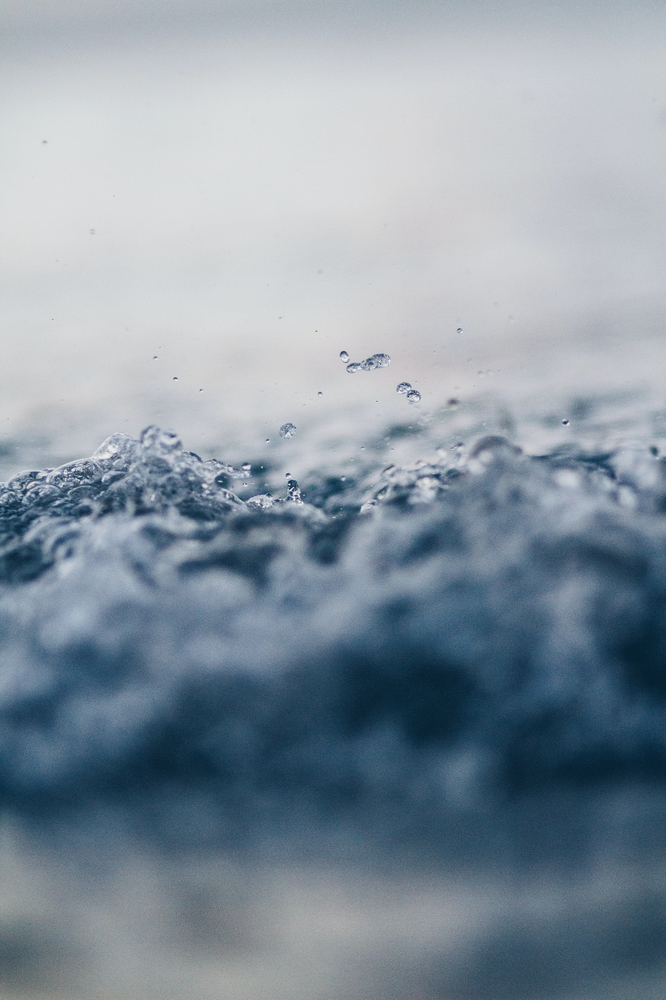

In [31]:
from PIL import Image
display(Image.open('backgrounds/unsplash_temp.png'))

In [4]:
from PIL import Image

def compress_and_resize_image(input_image_path, output_image_path, format='JPEG', quality=85):
    """
    Compresses and resizes a PIL image to 1080p format while preserving the aspect ratio.
    The modified image is then saved in the specified format with the given quality.

    Parameters:
        input_image_path (str): Path to the input PIL image file.
        output_image_path (str): Path to save the compressed and resized image.
        format (str, optional): The image format to save the output image. Default is 'JPEG'.
        quality (int, optional): The image quality for compression (0 to 100).
        Only applicable for 'JPEG' format. Default is 85.
    """
    try:
        # Open the input image
        image = Image.open(input_image_path)

        # Get the original image size
        width, height = image.size

        # Calculate the new size with the same aspect ratio as 1080p (1920x1080)
        aspect_ratio = width / height
        new_width = 1080 * aspect_ratio
        new_size = (int(new_width), 1080)

        # Resize the image while preserving the aspect ratio
        resized_image = image.resize(new_size, Image.LANCZOS)

        # Compress and save the resized image with the specified format and quality
        resized_image.save(output_image_path, format=format, quality=quality)

        # print("Image compression and resizing to 1080p successful!")
    except Exception as e:
        print(f"Error: {e}")

# Example usage:
input_image_path = "backgrounds/unsplash_temp.png"
output_image_path = "backgrounds/unsplash_temp_compressed.jpg"
compress_and_resize_image(input_image_path, output_image_path, format='JPEG', quality=70)


In [14]:
import os
import time
import requests
for i in range(30):
    time.sleep(1)
    print(i)
    photos = pu.photos(type_='random', count=1, featured=True, query="nature")
    [photo] = photos.entries
    # print(photo.id, photo.link_download)
    response = requests.get(photo.link_download, allow_redirects=True)
    input_image_path = 'backgrounds/'+photo.id+'.png'
    open(input_image_path, 'wb').write(response.content)
    output_image_path = 'backgrounds/compressed/'+photo.id+'.jpg'
    compress_and_resize_image(input_image_path, output_image_path, format='JPEG', quality=70)
    # display(Image.open(output_image_path))
    os.remove(input_image_path)

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
